<a href="https://colab.research.google.com/github/landskris/Semester-project-detectron2-models/blob/master/mrcnn_grabcut_grini_nc_1024_two_classes_baseline_augmented_new_min_anchor_only_and_max_det.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Notebook for training of Grini all and NC 1024 buildings and boats classes the best augmentation ( cropping and random hor flip ) + only one new anchor, the samllest one and capping max detections, with Mask-RCNN.

Installing detectron2 dependencies

In [9]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 12.8MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=34ce6b956c44c6d1dd65fc5adc4e01eb01d130a25b0f9149c438707f0414da4a
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [10]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 834kB/s 
     |████████████████████████████████| 2.2MB 23.5MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201122-cp36-none-any.whl size=44456 sha256=1c5d669b2f958c21f99c65237243fbfa792b5c6020342ed2b04e38f0e8e700e5
  Stored in directory: /root/.cache/pip/wheels/33/7b/ec/59dffd0a0aa995739aad60ac97e70252247e9d17eae69c1cee
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Import data and register 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Extract Grabcut json annotations

In [29]:
from os.path import join
data_dir = '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline'

train_imgs = join(data_dir, 'train_imgs')
val_imgs = join(data_dir, 'val_imgs')
test_imgs = join(data_dir, 'test_imgs')

train_annos = join(data_dir, 'grabcut_train.json')
val_annos = join(data_dir, 'grabcut_val.json')
test_annos = join(data_dir, 'grabcut_test.json')

# Check example path is correct 
train_imgs


'/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/train_imgs'

Register dataset 

In [3]:
# Register dataset configs
from detectron2.data.datasets import register_coco_instances
register_coco_instances('train', {}, train_annos, train_imgs)
register_coco_instances('val', {}, val_annos, val_imgs)
register_coco_instances('test', {}, test_annos, test_imgs)

In [ ]:
print('Total dataset images is: {}'.format(len(DatasetCatalog.get("train")) + len(DatasetCatalog.get("val")) + len(DatasetCatalog.get("test"))))

Total dataset images is: 2520


Visualize some samples in train, val and test

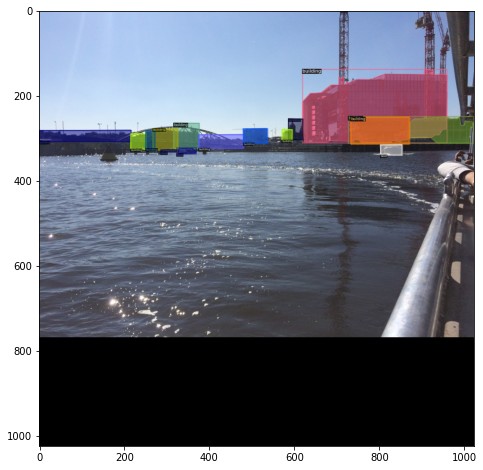

In [ ]:
import matplotlib.pyplot as plt

my_dataset_train_metadata = MetadataCatalog.get("train")
dataset_dicts = DatasetCatalog.get("train")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

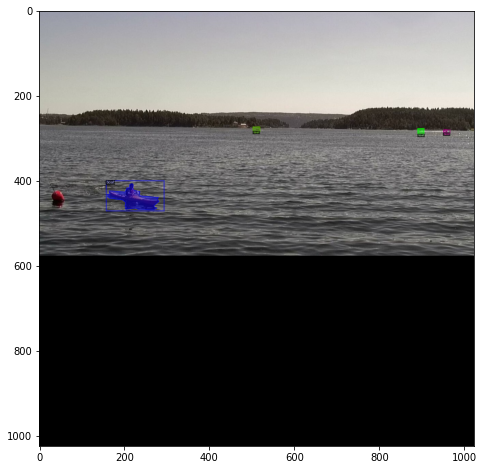

In [ ]:
import matplotlib.pyplot as plt

my_dataset_val_metadata = MetadataCatalog.get("val")
dataset_dicts = DatasetCatalog.get("val")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_val_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

[12/02 10:22:41 d2.data.datasets.coco]: Loaded 380 images in COCO format from /content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_test.json


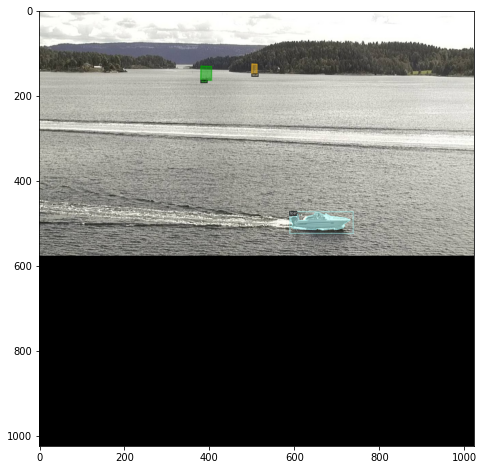

In [43]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

# Check assigned GPU 

In [ ]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 15308660687716258542, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9318509050547562128
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9945112075415738454
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14563024576
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 2051053646764313614
 physical_device_desc: "device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:04.0, compute capability: 7.0"]

# Set up model config and initiate training 

In [4]:
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.config import get_cfg
from detectron2.modeling import build_model
from os import getcwd, makedirs
from detectron2.utils import comm

# Model configuration 
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml'))
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl" # Path pasted from model zoo online 

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for testing 
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 12
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # Boat, building

# Add new aspect ratios 
cfg.MODEL.ANCHOR_GENERATOR.ASPECT_RATIOS = [[0.25, 0.5, 1.0, 2.0]]  # Added a larger H/W aspect ratio of 3 and a smaller for 0.25

# Augmentation -> All augmentations in training done in CustomTrainer 

cfg.INPUT.MIN_SIZE_TRAIN = (1000,)  # Avoid re-scaling of already scaled images 
cfg.INPUT.MIN_SIZE_TEST = 1000
# Max is default 1333, will not affect 


cfg.DATALOADER.NUM_WORKERS = 2
cfg.DATALOADER.FILTER_EMPTY_ANNOTATIONS = True
cfg.DATASETS.TRAIN = ('train',)
cfg.DATASETS.TEST = ('val',)  # For validation on training 


cfg.SOLVER.IMS_PER_BATCH = 2  # Two images per Gpu , only one GPU 
cfg.SOLVER.BASE_LR = 0.0003
# cfg.SOLVER.WARMUP_ITERS = 1000  # Default actually 
cfg.SOLVER.MAX_ITER = 20000  # adjust up if val mAP is still rising, adjust down if overfit,  INCREASE FOR REAL MODEL ... 
# cfg.SOLVER.STEPS = (1000, 1500)  # The iteration number to decrease learning rate by GAMMA
cfg.SOLVER.CHECKPOINT_PERIOD = 3000 # 2000  # Save model every 50th iteration -> TOO OFTEN, MUST CHANGE WHEN "REAL MODEL"
# cfg.SOLVER.GAMMA = 0.05

cfg.TEST.EVAL_PERIOD = 300 # 300  # How many steps before evaluate - TODO INCREASE WHEN REAL ITERATIONS
cfg.TEST.DETECTIONS_PER_IMAGE = 72  # Added after analysing dataset 

# Logging and checkpoint saving 
makedirs(cfg.OUTPUT_DIR, exist_ok=True)
setup_logger(output=cfg.OUTPUT_DIR, distributed_rank=comm.get_rank(), name="grabcut_grini_nc_1024_buildings_boats_faster_rcnn_baseline_augmented_new_min_anchor")

# checkpointer = DetectionCheckpointer(build_model(cfg), save_dir=cfg.OUTPUT_DIR)
# checkpointer.save("grini_nc_1024_faster_rcnn")  # save to output/model_999.pth
cfg.INPUT 


CfgNode({'MIN_SIZE_TRAIN': (1000,), 'MIN_SIZE_TRAIN_SAMPLING': 'choice', 'MAX_SIZE_TRAIN': 1333, 'MIN_SIZE_TEST': 1000, 'MAX_SIZE_TEST': 1333, 'RANDOM_FLIP': 'horizontal', 'CROP': CfgNode({'ENABLED': False, 'TYPE': 'relative_range', 'SIZE': [0.9, 0.9]}), 'FORMAT': 'BGR', 'MASK_FORMAT': 'polygon'})

Custom dataset mapper for more augemntations 

In [ ]:
#@title
# Copyright (c) Facebook, Inc. and its affiliates. All Rights Reserved
import copy
import logging
import numpy as np
from typing import List, Optional, Union
import torch

from detectron2.config import configurable

from detectron2.data import detection_utils as utils
from detectron2.data import transforms as T

"""
This file contains the default mapping that's applied to "dataset dicts".
"""

__all__ = ["DatasetMapper"]


class AugmentedDatasetMapper:
    """
    A callable which takes a dataset dict in Detectron2 Dataset format,
    and map it into a format used by the model.

    This is the default callable to be used to map your dataset dict into training data.
    You may need to follow it to implement your own one for customized logic,
    such as a different way to read or transform images.
    See :doc:`/tutorials/data_loading` for details.

    The callable currently does the following:

    1. Read the image from "file_name"
    2. Applies cropping/geometric transforms to the image and annotations
    3. Prepare data and annotations to Tensor and :class:`Instances`
    """

    @configurable
    def __init__(
        self,
        is_train: bool,
        *,
        augmentations: List[Union[T.Augmentation, T.Transform]],
        image_format: str,
        use_instance_mask: bool = False,
        use_keypoint: bool = False,
        instance_mask_format: str = "polygon",
        keypoint_hflip_indices: Optional[np.ndarray] = None,
        precomputed_proposal_topk: Optional[int] = None,
        recompute_boxes: bool = False
    ):
        """
        NOTE: this interface is experimental.

        Args:
            is_train: whether it's used in training or inference
            augmentations: a list of augmentations or deterministic transforms to apply
            image_format: an image format supported by :func:`detection_utils.read_image`.
            use_instance_mask: whether to process instance segmentation annotations, if available
            use_keypoint: whether to process keypoint annotations if available
            instance_mask_format: one of "polygon" or "bitmask". Process instance segmentation
                masks into this format.
            keypoint_hflip_indices: see :func:`detection_utils.create_keypoint_hflip_indices`
            precomputed_proposal_topk: if given, will load pre-computed
                proposals from dataset_dict and keep the top k proposals for each image.
            recompute_boxes: whether to overwrite bounding box annotations
                by computing tight bounding boxes from instance mask annotations.
        """
        if recompute_boxes:
            assert use_instance_mask, "recompute_boxes requires instance masks"
        # fmt: off
        self.is_train               = is_train
        self.augmentations          = augmentations
        self.image_format           = image_format
        self.use_instance_mask      = use_instance_mask
        self.instance_mask_format   = instance_mask_format
        self.use_keypoint           = use_keypoint
        self.keypoint_hflip_indices = keypoint_hflip_indices
        self.proposal_topk          = precomputed_proposal_topk
        self.recompute_boxes        = recompute_boxes
        # fmt: on
        logger = logging.getLogger(__name__)
        logger.info("Augmentations used in training: " + str(augmentations))

    @classmethod
    def from_config(cls, cfg, is_train: bool = True):
        augs = utils.build_augmentation(cfg, is_train)

        if is_train:
            min_size = cfg.INPUT.MIN_SIZE_TRAIN
            max_size = cfg.INPUT.MAX_SIZE_TRAIN
            sample_style = cfg.INPUT.MIN_SIZE_TRAIN_SAMPLING
        else:
            min_size = cfg.INPUT.MIN_SIZE_TEST
            max_size = cfg.INPUT.MAX_SIZE_TEST
            sample_style = "choice"
        augmentation = [T.ResizeShortestEdge(min_size, max_size, sample_style)]
        if is_train:
            for aug in self.augmentations:
                augmentation.append(aug)
        recompute_boxes = cfg.MODEL.MASK_ON # Will need to do for rotation and flips 

        if cfg.INPUT.CROP.ENABLED and is_train:
            augs.insert(0, T.RandomCrop(cfg.INPUT.CROP.TYPE, cfg.INPUT.CROP.SIZE))
            recompute_boxes = cfg.MODEL.MASK_ON
        #else:
        #    recompute_boxes = False

        ret = {
            "is_train": is_train,
            "augmentations": augs,
            "image_format": cfg.INPUT.FORMAT,
            "use_instance_mask": cfg.MODEL.MASK_ON,
            "instance_mask_format": cfg.INPUT.MASK_FORMAT,
            "use_keypoint": cfg.MODEL.KEYPOINT_ON,
            "recompute_boxes": recompute_boxes,
        }
        if cfg.MODEL.KEYPOINT_ON:
            ret["keypoint_hflip_indices"] = utils.create_keypoint_hflip_indices(cfg.DATASETS.TRAIN)

        if cfg.MODEL.LOAD_PROPOSALS:
            ret["precomputed_proposal_topk"] = (
                cfg.DATASETS.PRECOMPUTED_PROPOSAL_TOPK_TRAIN
                if is_train
                else cfg.DATASETS.PRECOMPUTED_PROPOSAL_TOPK_TEST
            )
        return ret

    def __call__(self, dataset_dict):
        """
        Args:
            dataset_dict (dict): Metadata of one image, in Detectron2 Dataset format.

        Returns:
            dict: a format that builtin models in detectron2 accept
        """
        dataset_dict = copy.deepcopy(dataset_dict)  # it will be modified by code below
        # USER: Write your own image loading if it's not from a file
        image = utils.read_image(dataset_dict["file_name"], format=self.image_format)
        utils.check_image_size(dataset_dict, image)

        # USER: Remove if you don't do semantic/panoptic segmentation.
        if "sem_seg_file_name" in dataset_dict:
            sem_seg_gt = utils.read_image(dataset_dict.pop("sem_seg_file_name"), "L").squeeze(2)
        else:
            sem_seg_gt = None

        aug_input = T.StandardAugInput(image, sem_seg=sem_seg_gt)
        transforms = aug_input.apply_augmentations(self.augmentations)
        image, sem_seg_gt = aug_input.image, aug_input.sem_seg

        image_shape = image.shape[:2]  # h, w
        # Pytorch's dataloader is efficient on torch.Tensor due to shared-memory,
        # but not efficient on large generic data structures due to the use of pickle & mp.Queue.
        # Therefore it's important to use torch.Tensor.
        dataset_dict["image"] = torch.as_tensor(np.ascontiguousarray(image.transpose(2, 0, 1)))
        if sem_seg_gt is not None:
            dataset_dict["sem_seg"] = torch.as_tensor(sem_seg_gt.astype("long"))

        # USER: Remove if you don't use pre-computed proposals.
        # Most users would not need this feature.
        if self.proposal_topk is not None:
            utils.transform_proposals(
                dataset_dict, image_shape, transforms, proposal_topk=self.proposal_topk
            )

        if not self.is_train:
            # USER: Modify this if you want to keep them for some reason.
            dataset_dict.pop("annotations", None)
            dataset_dict.pop("sem_seg_file_name", None)
            return dataset_dict

        if "annotations" in dataset_dict:
            # USER: Modify this if you want to keep them for some reason.
            for anno in dataset_dict["annotations"]:
                if not self.use_instance_mask:
                    anno.pop("segmentation", None)
                if not self.use_keypoint:
                    anno.pop("keypoints", None)

            # USER: Implement additional transformations if you have other types of data
            annos = [
                utils.transform_instance_annotations(
                    obj, transforms, image_shape, keypoint_hflip_indices=self.keypoint_hflip_indices
                )
                for obj in dataset_dict.pop("annotations")
                if obj.get("iscrowd", 0) == 0
            ]
            instances = utils.annotations_to_instances(
                annos, image_shape, mask_format=self.instance_mask_format
            )

            # After transforms such as cropping are applied, the bounding box may no longer
            # tightly bound the object. As an example, imagine a triangle object
            # [(0,0), (2,0), (0,2)] cropped by a box [(1,0),(2,2)] (XYXY format). The tight
            # bounding box of the cropped triangle should be [(1,0),(2,1)], which is not equal to
            # the intersection of original bounding box and the cropping box.
            if self.recompute_boxes:
                instances.gt_boxes = instances.gt_masks.get_bounding_boxes()
            dataset_dict["instances"] = utils.filter_empty_instances(instances)
        return dataset_dict


Create custom evaluator trainer

In [5]:
#@title

import logging
from os import makedirs
from os.path import join

from detectron2.engine import DefaultTrainer
from detectron2.engine.hooks import HookBase
from detectron2.evaluation import inference_context, COCOEvaluator
from detectron2.utils.logger import log_every_n_seconds
from detectron2.data import DatasetMapper, build_detection_test_loader, build_detection_train_loader
import detectron2.utils.comm as comm
import torch
import time
import datetime
import numpy as np


class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader

    def _do_loss_eval(self):
        # Copying inference_on_dataset from evaluator.py
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)

        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []
        for idx, inputs in enumerate(self._data_loader):
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation  done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)), n=5, )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)
        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()

        return losses

    def _get_loss(self, data):
        # How loss is calculated on train_loop
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced

    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            self._do_loss_eval()
        self.trainer.storage.put_scalars(timetest=12)


class CustomValTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, False, output_folder)

    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1, LossEvalHook(
            self.cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg, True)
            )
        ))
        return hooks

    @classmethod
    def build_train_loader(cls, cfg):
        """
        Custom train loader applying random rotation, flipping and cropping
        """
        from detectron2.data import transforms as T
        min_size = cfg.INPUT.MIN_SIZE_TRAIN
        max_size = cfg.INPUT.MAX_SIZE_TRAIN
        sample_style = cfg.INPUT.MIN_SIZE_TRAIN_SAMPLING
        
        # Trust the __call__ in Dataset mapper to accordingly transform transformations
        augs = [T.ResizeShortestEdge(min_size, max_size, sample_style),
                T.RandomFlip(prob=0.5, horizontal=True, vertical=False),
                # T.RandomRotation(angle=[0, 25]), # Rotate up
                # T.RandomRotation(angle=[-25, 0]), # Rotate down
                T.RandomCrop(crop_type='relative_range', crop_size=(0.7, 0.7))]
        mapper = DatasetMapper(cfg, True, augmentations=augs)
        return build_detection_train_loader(cfg, mapper=mapper)

    




20k iterations runs below 

In [ ]:
# Run with only random flip and random crop 
trainer = CustomValTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/01 17:56:46 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.0' to the model due to incompatible shapes: (3, 4) in the checkpoint but (4, 4) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.1' to the model due to incompatible shapes: (3, 4) in the checkpoint but (4, 4) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.2' to the model due to incompatible shapes: (3, 4) in the checkpoint but (4, 4) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.3' to the model due to incompatible shapes: (3, 4) in the checkpoint but (4, 4) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.4' to the model due to incompatible shapes: (3, 4) 

[12/01 17:56:48 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

Streaming output truncated to the last 5000 lines.
|:------:|:------:|:------:|:------:|:------:|:------:|
| 28.319 | 52.786 | 26.024 | 12.862 | 27.156 | 47.326 |
[12/01 19:20:24 d2.evaluation.coco_evaluation]: Per-category bbox AP: 
| category   | AP     | category   | AP     |
|:-----------|:-------|:-----------|:-------|
| building   | 18.736 | boat       | 37.902 |
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
COCOeval_opt.evaluate() finished in 0.16 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.01 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.193
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.439
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.146
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.066
 Average Precision  (AP) @

In [ ]:
# Save final results to drive, filter them later, if large run, consider zipping before saving to drive 
!cp "/content/output" -r "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor" 


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

If runtime off, re-mount the drive and load tensorboard from the output folder in drive 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
saved_output_dir = "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor" 

In [3]:
# Inspect tensorflow logged events 
!find "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor"     | grep tfevents

/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor/events.out.tfevents.1606839600.a4fce0a13c74.130.0
/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor/events.out.tfevents.1606845408.a4fce0a13c74.722.0


In [ ]:
tensorboard --inspect --logdir "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor" 

In [5]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor"     # saved_output_dir
# %tensorboard --logdir output

<IPython.core.display.Javascript object>

Plot validation and training together 

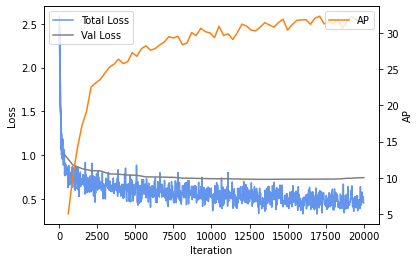

In [49]:
import json
import matplotlib.pyplot as plt

experiment_folder =  saved_output_dir# cfg.OUTPUT_DIR

def load_json_arr(json_path):
    lines = []
    with open(json_path, 'r') as f:
        for line in f:
            lines.append(json.loads(line))
    return lines

experiment_metrics = load_json_arr(experiment_folder + '/metrics.json')

fig, ax1 = plt.subplots(facecolor='w')

color = 'tab:blue'
ax1.set_xlabel('Iteration')
ax1.set_ylabel('Loss')

ax1.plot(
    [x['iteration'] for x in experiment_metrics if 'total_loss' in x], 
    [x['total_loss'] for x in experiment_metrics if 'total_loss' in x], color="cornflowerblue", label="Total Loss")
ax1.plot(
    [x['iteration'] for x in experiment_metrics if 'validation_loss' in x], 
    [x['validation_loss'] for x in experiment_metrics if 'validation_loss' in x], color="gray", label="Val Loss")
    
ax1.tick_params(axis='y')
plt.legend(loc='upper left')

ax2 = ax1.twinx()

color = 'tab:orange'
ax2.set_ylabel('AP')
ax2.plot(
    [x['iteration'] for x in experiment_metrics if 'bbox/AP' in x], 
    [x['bbox/AP'] for x in experiment_metrics if 'bbox/AP' in x], color=color, label="AP")
ax2.tick_params(axis='y')

plt.legend(loc='upper right')
plt.show()

#Test predictions 

In [8]:
import os
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0017999.pth") # We take model from step 18k here 
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

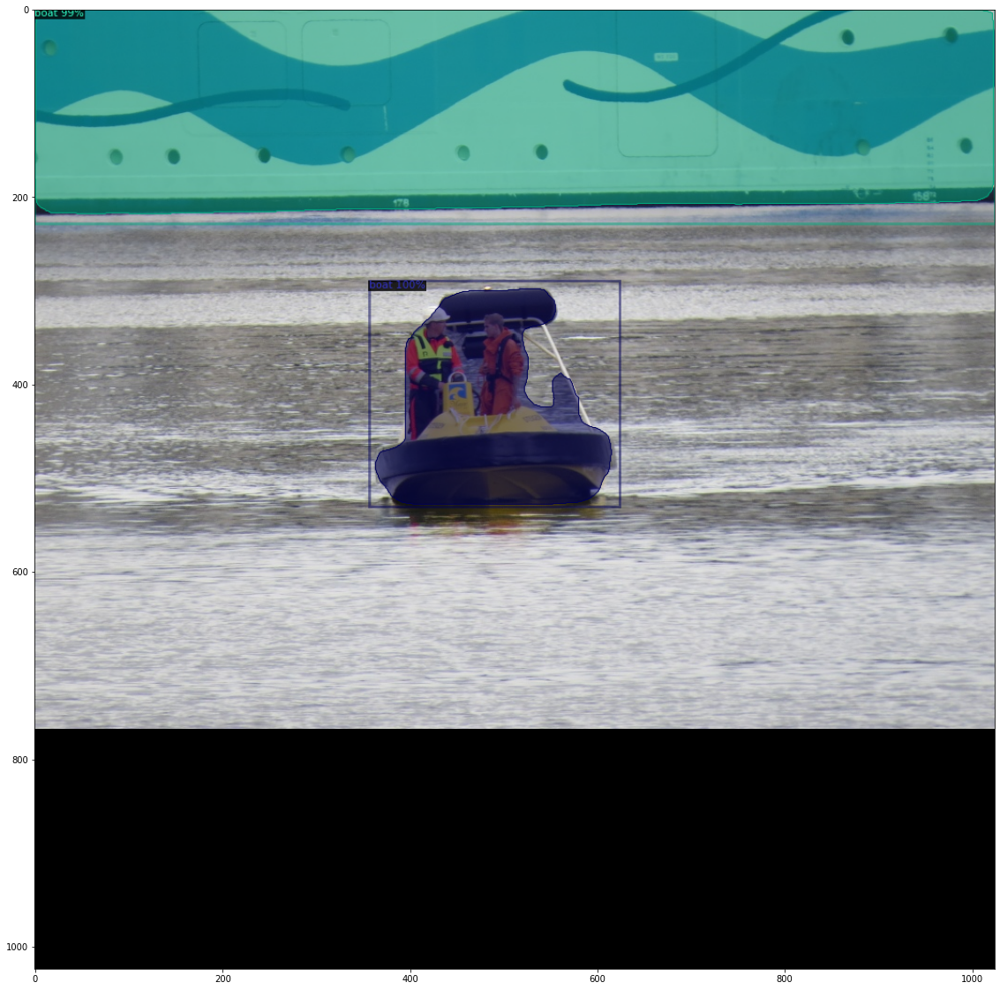

In [11]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")
plt.figure(figsize = (20, 20))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(out.get_image()[:, :, :])

# dataset_dicts 

#Test inference

In [12]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
makedirs('test_output', exist_ok=True)
cfg.OUTPUT_DIR = 'test_output'
cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0017999.pth")  # Best model, slightly overfitted but so much better AP it is fine 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for testing ensure it is the same as during evaluation, lower this can give us better AP as we keep more predictions 
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("test", ("bbox", "segm"), False, output_dir="./test_output/test_inference")

# Re-define trainer and load if run-time reset 
trainer = CustomValTrainer(cfg)
trainer.resume_or_load(resume=True)  # Resume from model weights overwritten above 

val_loader = build_detection_test_loader(cfg, "test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))  # Same trainer as before 
# another equivalent way to evaluate the model is to use `trainer.test`

[12/02 09:05:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [13]:
# Copy test inference results to drive 
!cp "/content/test_output" -r "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_output_faster_rcnn_baseline_augmented_new_min_anchor/test_inference_only"

# Prediction examples for similar images all detectors 

In [45]:
import os 
# Samples to visualize 
sailboat = '190618_082821.jpg'
large_boat_distance = '190620_075745.jpg'
rainy_boat_in_horizon = 'IMG_2510.jpg'

small_kayak_close = 'extra_kayak_axis0005.jpg'
small_boat_distance_sunny = 'selected_08_07_frame2166.jpg'
more_boats_horizon = 'selected_08_04_frame1730.jpg'
scattered_small_boats = 'selected_08_10_frame0330.jpg'
grini_comparison_photo = 'IMG_2075.jpg'
extremely_difficult = 'selected_06_14_axis0051.jpg'
amsterdam = '190628_175252.jpg'
singapore_horizon_boats = 'IMG_9244.jpg'

sample_names = [sailboat, large_boat_distance, rainy_boat_in_horizon, small_kayak_close, small_boat_distance_sunny, more_boats_horizon,  scattered_small_boats, grini_comparison_photo, 
                extremely_difficult, amsterdam, singapore_horizon_boats]
sample_paths = [os.path.join(test_imgs, sample_name) for sample_name in sample_names]

sample_paths

['/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/190618_082821.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/190620_075745.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/IMG_2510.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/extra_kayak_axis0005.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/selected_08_07_frame2166.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/selected_08_04_frame1730.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/selected_08_10_frame0330.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/IMG_2075.jpg',
 '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/test_imgs/

[12/02 10:33:40 d2.data.datasets.coco]: Loaded 380 images in COCO format from /content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_test.json
Found matching image of name 190618_082821.jpg
Found matching image of name 190620_075745.jpg
Found matching image of name 190628_175252.jpg
Found matching image of name extra_kayak_axis0005.jpg
Found matching image of name IMG_2075.jpg
Found matching image of name IMG_2510.jpg
Found matching image of name IMG_9244.jpg
Found matching image of name selected_06_14_axis0051.jpg
Found matching image of name selected_08_04_frame1730.jpg
Found matching image of name selected_08_07_frame2166.jpg
Found matching image of name selected_08_10_frame0330.jpg


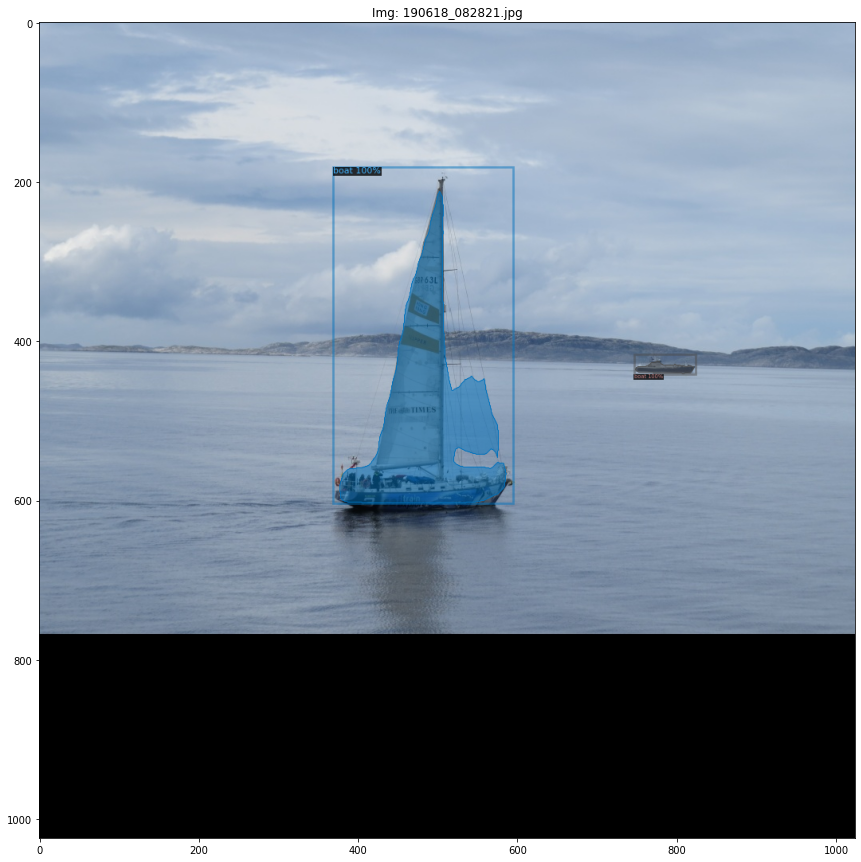

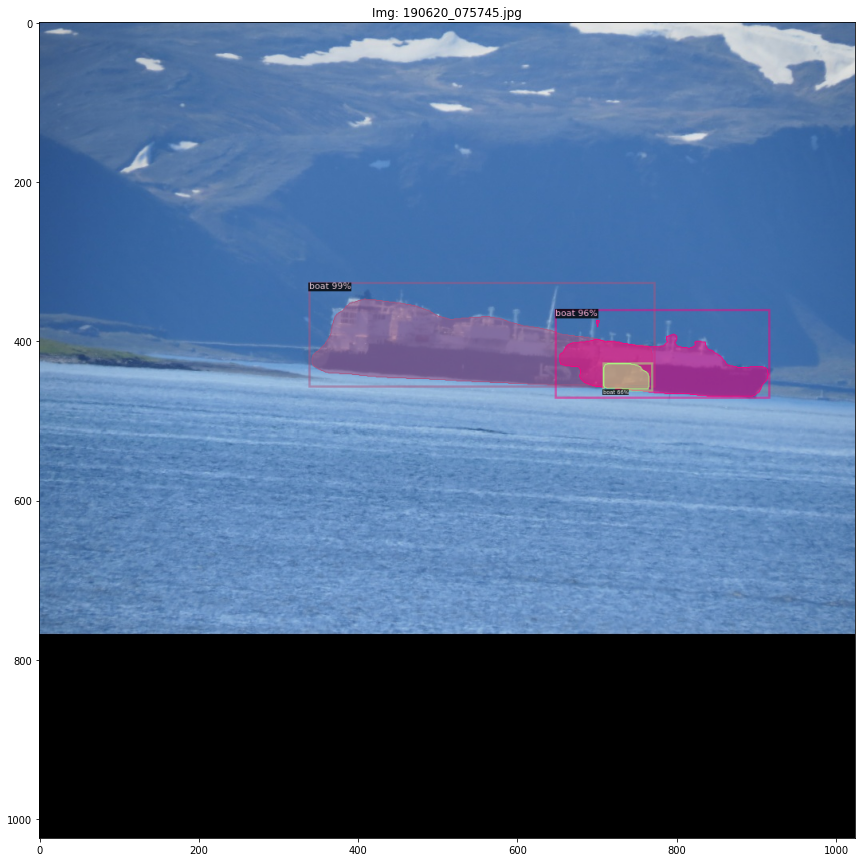

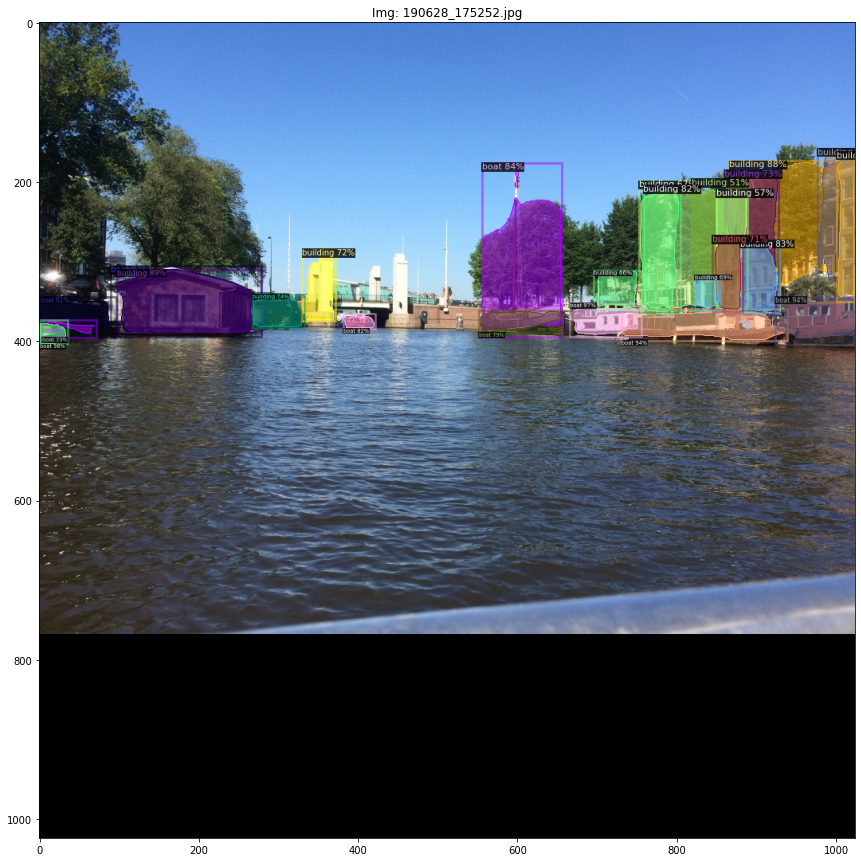

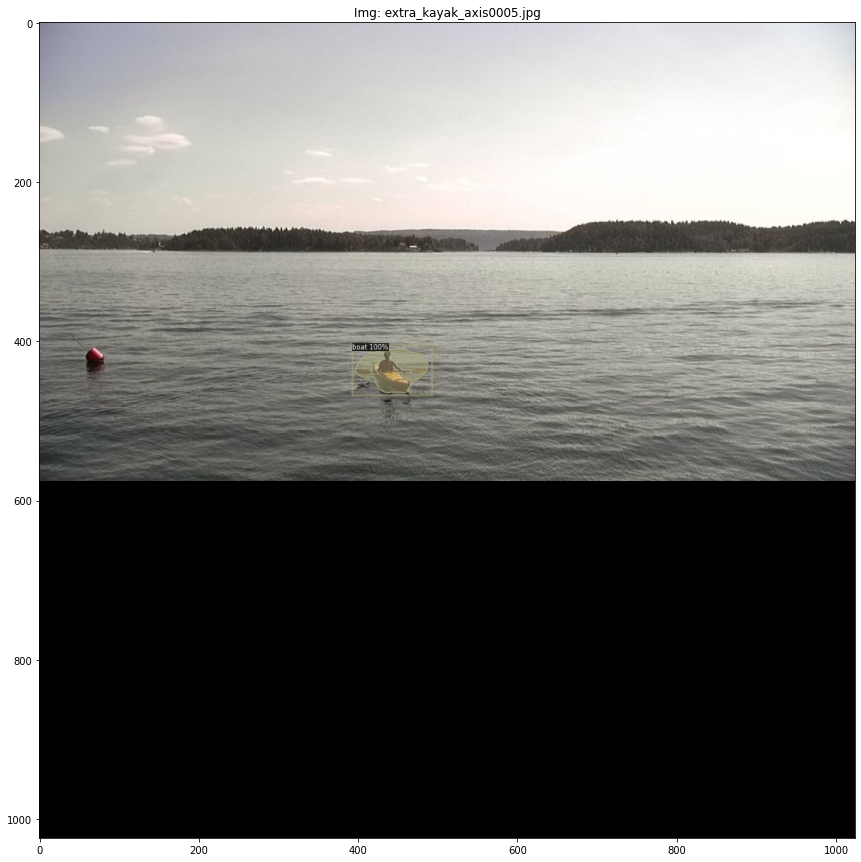

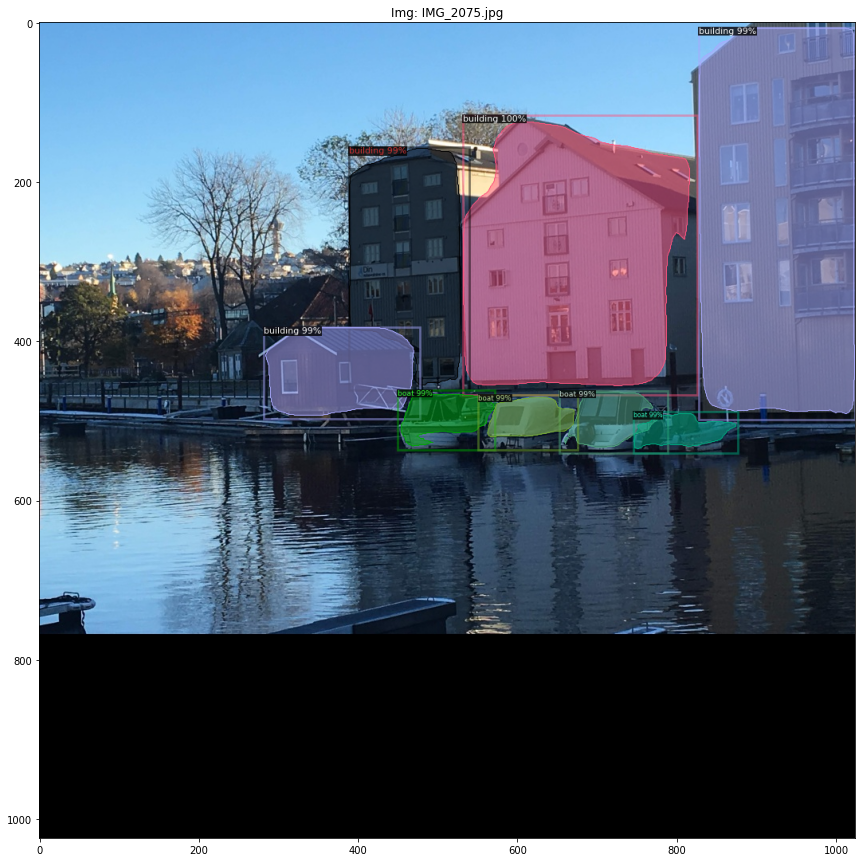

...

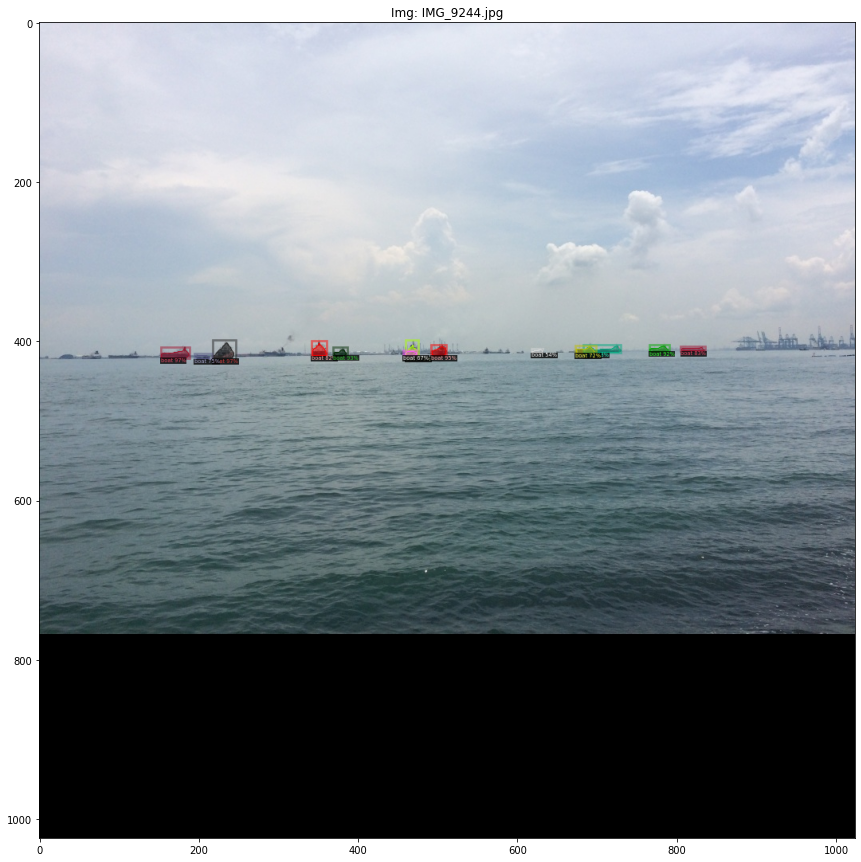

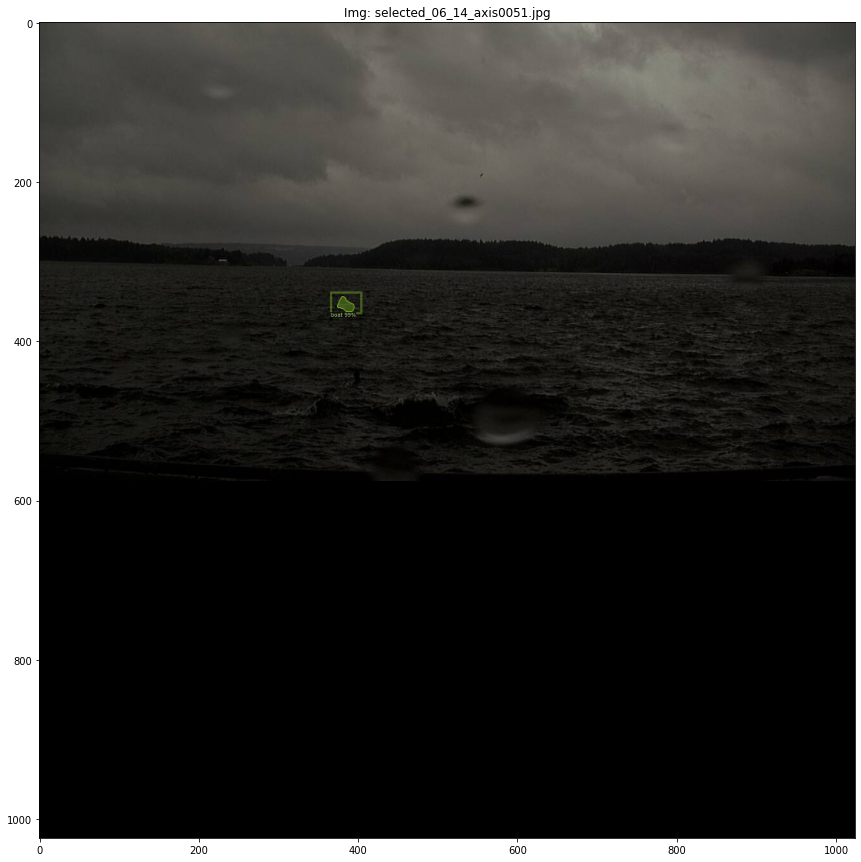

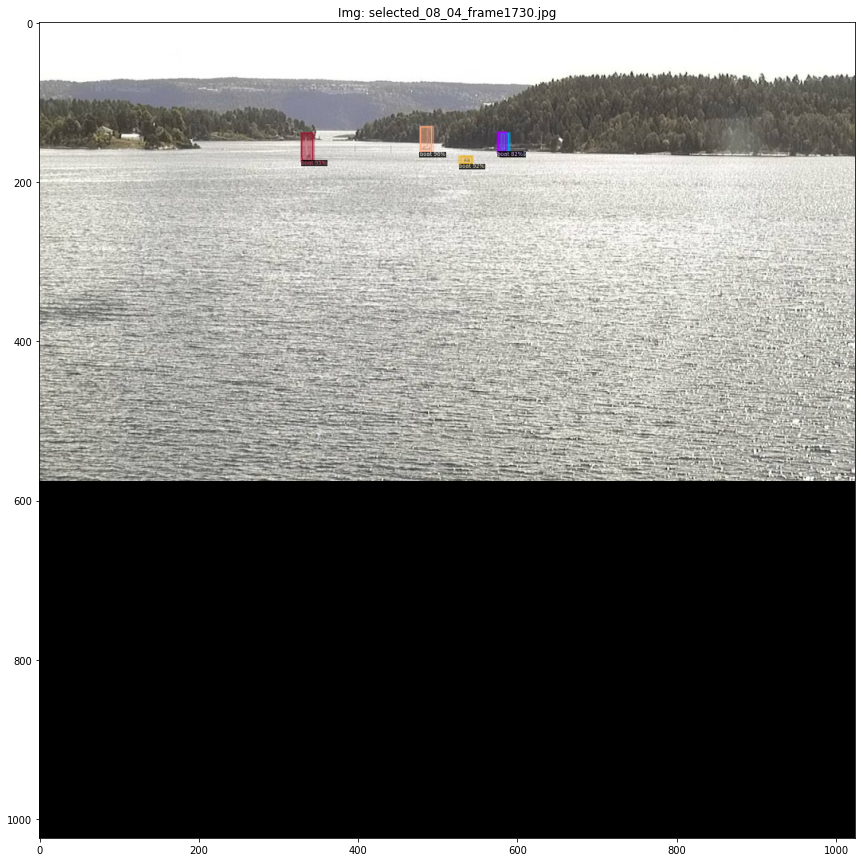

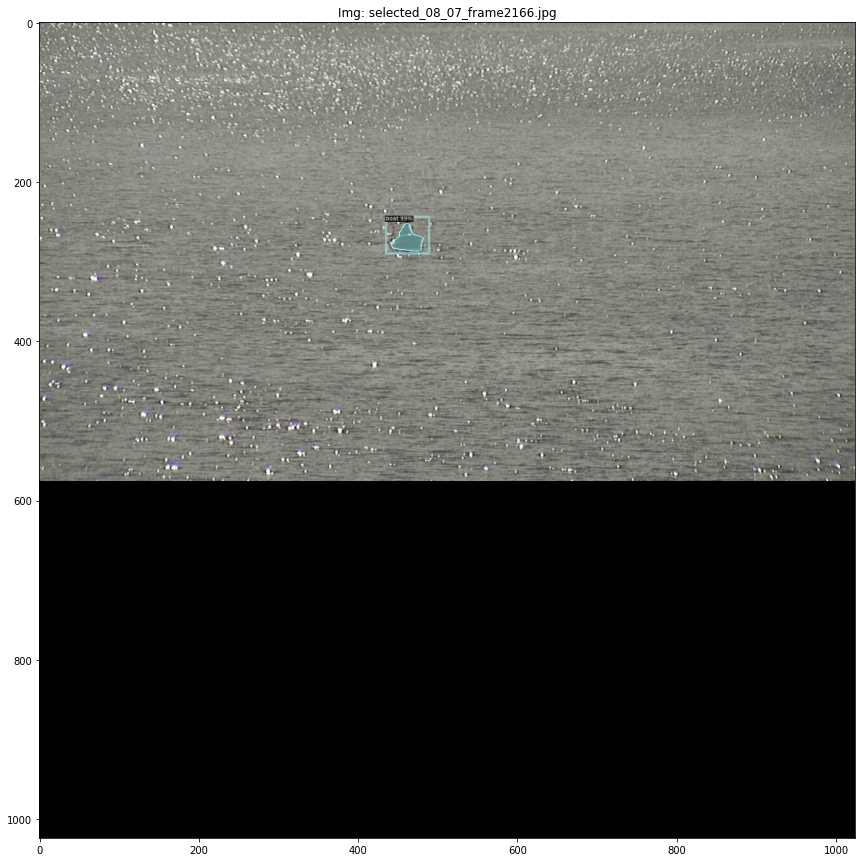

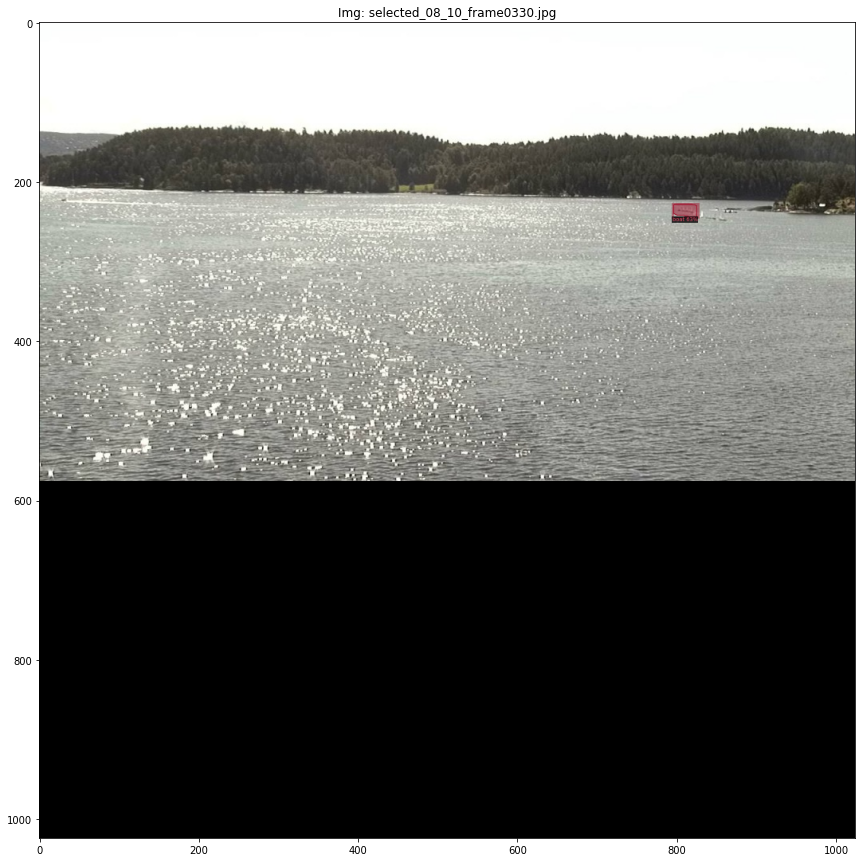

In [48]:
import matplotlib.pyplot as plt
import os

cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0017999.pth") # We take model from step 18k here 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")

# counter = 0
# fig, ax = plt.subplots(len(sample_paths), figsize = (12*len(sample_paths), 12*len(sample_paths)))
for container in (dataset_dicts):
    if container['file_name'] in sample_paths:
      fig = plt.figure(figsize =(15,15))
      print('Found matching image of name {}'.format(os.path.basename(container['file_name'])))      
      img = cv2.imread(container['file_name'])
      outputs = predictor(img)
      visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
      out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
      plt.imshow(out.get_image()[:, :, :])
      plt.title('Img: {}'.format(os.path.basename(container['file_name'])))
      # ax[counter].imshow(out.get_image()[:, :, :])
      # ax[counter].set_title('Img: {}'.format(os.path.basename(container['file_name'])))
      # counter +=1 

# dataset_dicts 

# Draw ground truths 

[12/02 10:32:15 d2.data.datasets.coco]: Loaded 380 images in COCO format from /content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_test.json
Found matching image of name 190618_082821.jpg
Found matching image of name 190620_075745.jpg
Found matching image of name 190628_175252.jpg
Found matching image of name extra_kayak_axis0005.jpg
Found matching image of name IMG_2075.jpg
Found matching image of name IMG_2510.jpg
Found matching image of name IMG_9244.jpg
Found matching image of name selected_06_14_axis0051.jpg
Found matching image of name selected_08_04_frame1730.jpg
Found matching image of name selected_08_07_frame2166.jpg
Found matching image of name selected_08_10_frame0330.jpg


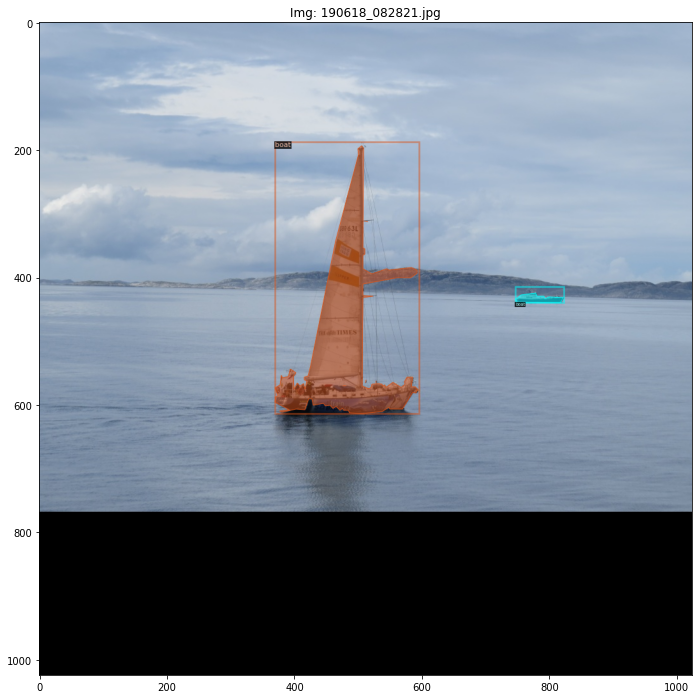

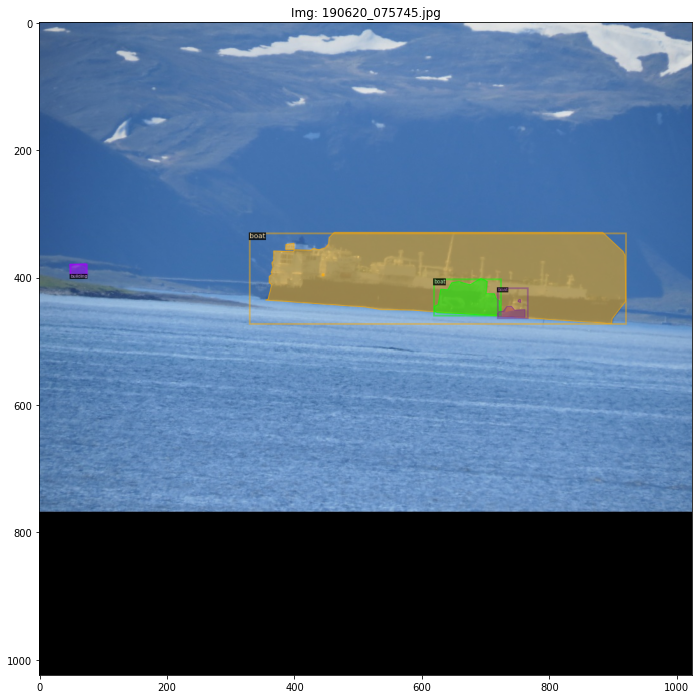

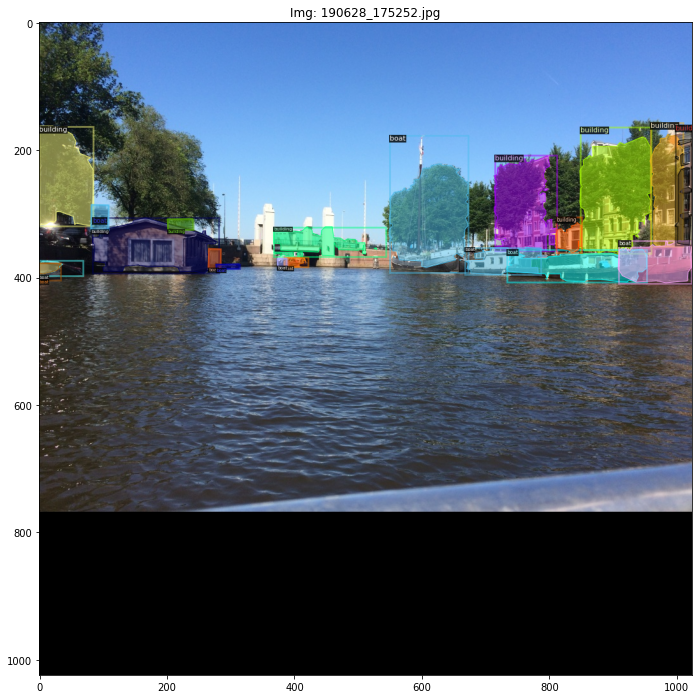

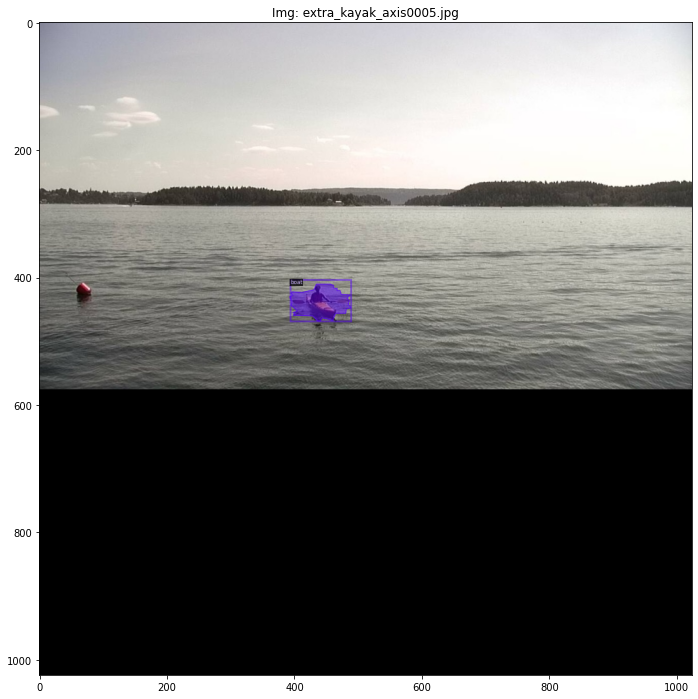

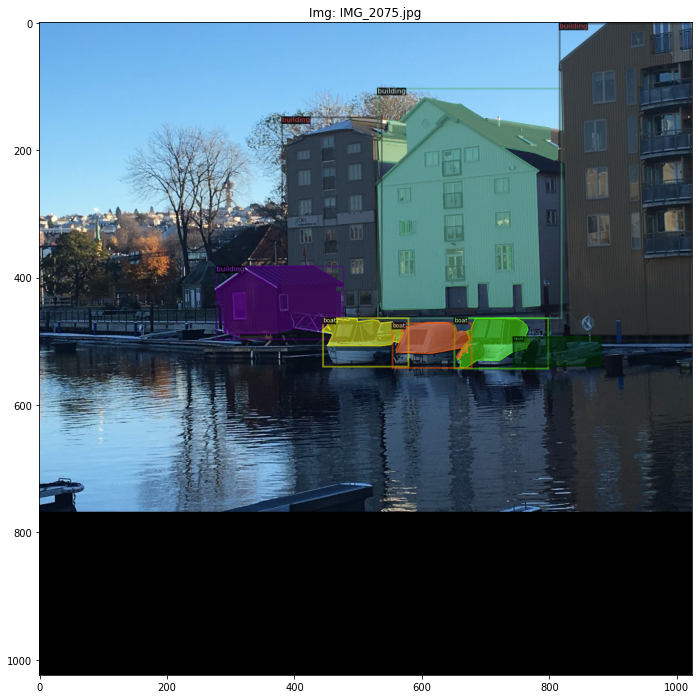

...

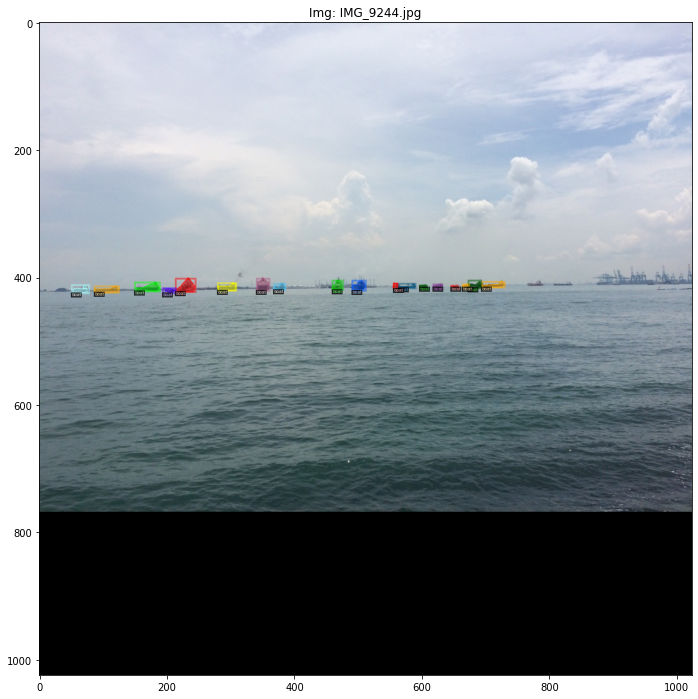

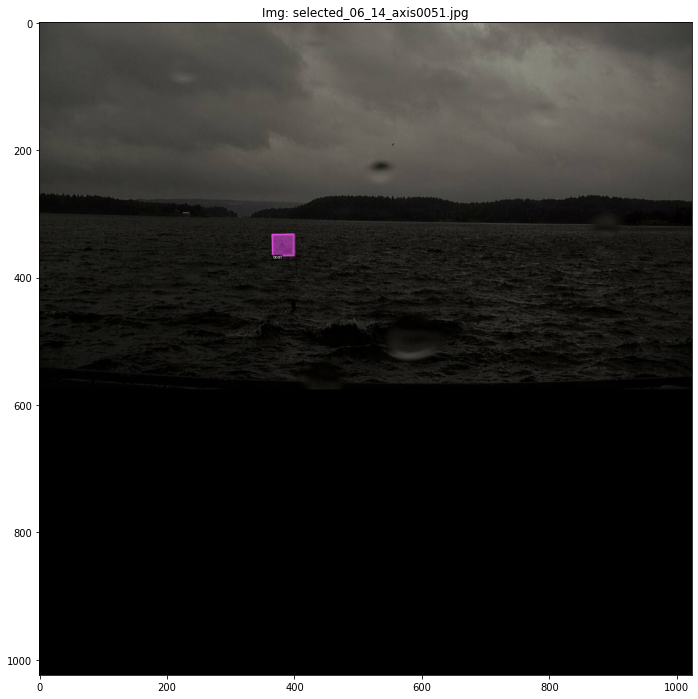

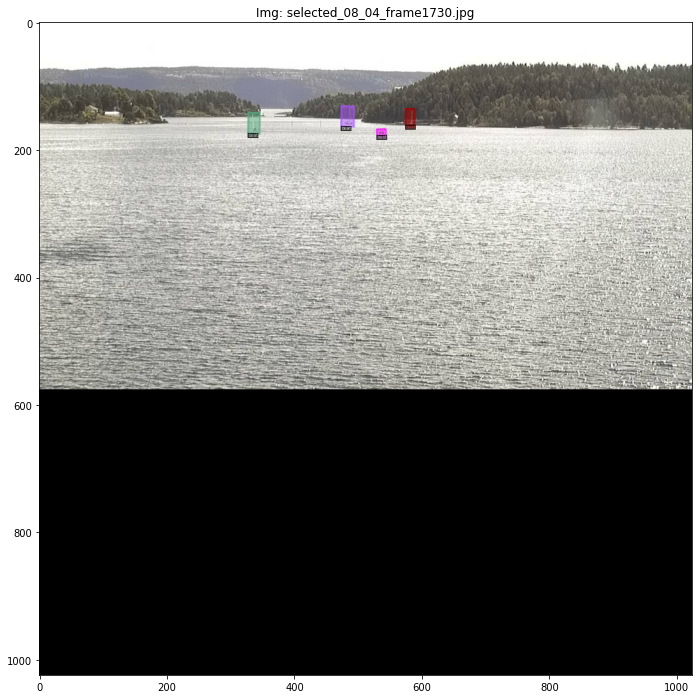

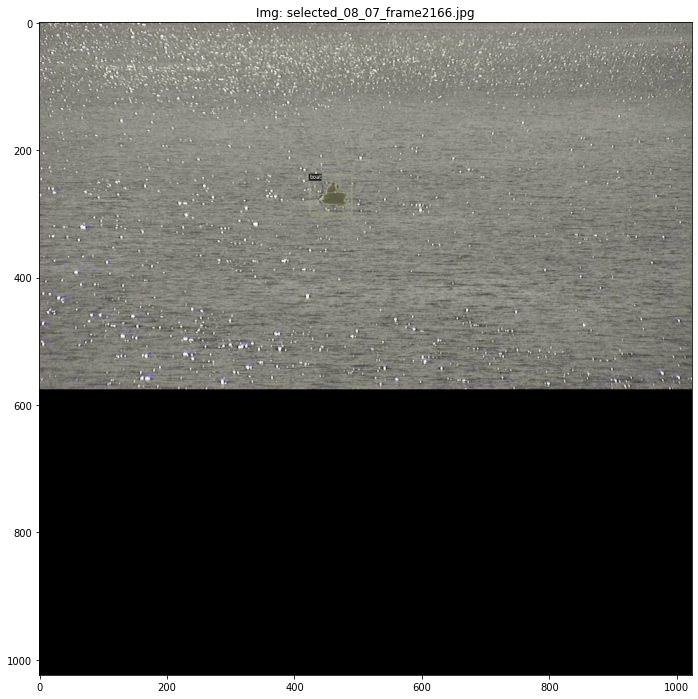

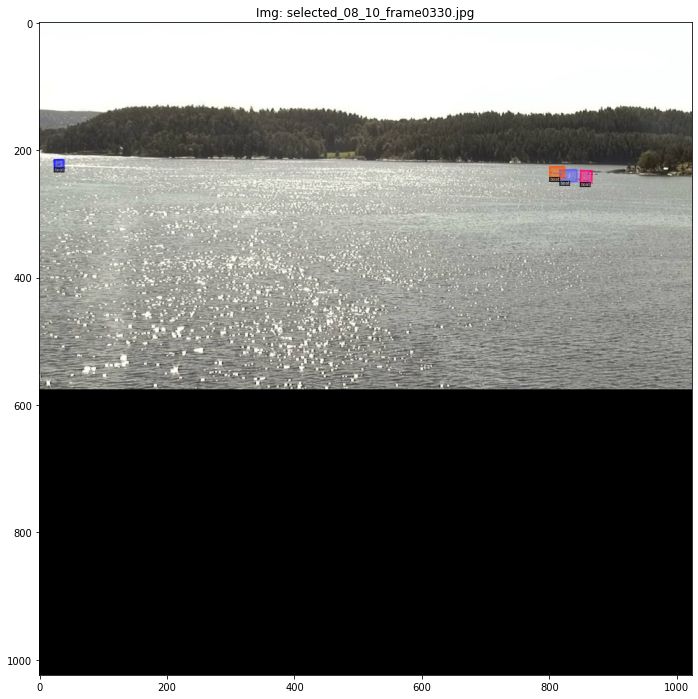

In [47]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")


for container in (dataset_dicts):
    if container['file_name'] in sample_paths:
      fig = plt.figure(figsize =(12,12))
      print('Found matching image of name {}'.format(os.path.basename(container['file_name'])))      
      img = cv2.imread(container['file_name'])      
      visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
      vis = visualizer.draw_dataset_dict(container)
      plt.imshow(vis.get_image()[:, :, :])
      plt.title('Img: {}'.format(os.path.basename(container['file_name'])))


# Draw predictions with ground truth bboxes overlayed

In [ ]:
# Nope, will be to hard to visualize